# Visualizing collective behavior
Five behaviors (so far): following teammate, assist, escort, spawn-camping, cycling

Visualizations and statistics:
* Top-down video of gameplay with behavior indicator time series
* Scatter plot of game-by-game behavior frequency versus team score
* Game-by-game team difference in behavior frequency versus difference in score
* Correlation between team score and behavior frequency
* T-test for difference in behavior frequency for wins – losses
* Plot team behavior frequencies for wins and losses
* Epoch behavior occurrences before and after (-4 to +4 s) scoring events across maps
* Plot behavior indicator alongside match summary of score, distances, and values
* Correlate behavior indicator with player expected value
* T-test for difference in value for behavior ON and OFF
* Plot value score at time points for behavior ON and OFF

TODO:
* Compare behavior frequency to winning or losing game states (and score difference magnitude)
* Plot frequency of behavior over the course of game
* I.e. does behavior occur more or less in early vs latter part of game, or track with score differential
* Randomly sample non-behavior time points of same size
* Plot overlap of different behaviors

In [1]:
from os.path import join
import tempfile
import ffmpeg
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib.backends.backend_agg import FigureCanvasAgg
import seaborn as sns
from IPython.display import Video

from ctf_dataset import info
from ctf_dataset.tools import video as tools_video
from ctf_dataset.load import create_wrapped_dataset

In [2]:
base_dir = '/jukebox/hasson/snastase/social-ctf'
data_dir = join(base_dir, 'data_v1')
wrap_f = create_wrapped_dataset(data_dir, output_dataset_name="virtual.hdf5")

In [3]:
# Function to create top-down game video
def time_series_top(time_series, wrap_f, map_id, matchup_id, repeat_id, label=None, filename=None):
    frames = wrap_f["map/matchup/repeat/time/top"][map_id, matchup_id, repeat_id, slice(None)]

    if not filename:
        tmp = tempfile.NamedTemporaryFile(suffix=".mp4")
        tmp_name = tmp.name + ""
    else:
        tmp_name = filename
        
    if wrap_f['map/matchup/repeat/player/color_id'][
        map_id, matchup_id, repeat_id, 0][0] == 0:
        team_colors = ['darkred', 'darkblue']
    elif wrap_f['map/matchup/repeat/player/color_id'][
        map_id, matchup_id, repeat_id, 0][0] == 1:
        team_colors = ['darkblue', 'darkred']

    fig = plt.figure(constrained_layout=False, figsize=(6, 1), dpi=90)
    canvas = FigureCanvasAgg(fig)
    ts_shape = canvas.get_width_height()[::-1] + (3,)
    gs1 = fig.add_gridspec(nrows=6, top=1, bottom=0.17,
                           left=.02, right=.98,
                           height_ratios=[1, 1, .2, 1, 1, .2])
    ax1 = fig.add_subplot(gs1[0])
    ax1.set_xlim(0, len(time_series[0]))
    ax1.plot(time_series[0], c=team_colors[0])
    ax1.axis('off')
    ax2 = fig.add_subplot(gs1[1])
    ax2.set_xlim(0, len(time_series[0]))
    ax2.plot(time_series[1], c=team_colors[0])
    ax2.axis('off')
    ax3 = fig.add_subplot(gs1[2])
    ax3.set_xlim(0, len(time_series[0]))
    ax3.set_ylim(0, 1)
    t0, = ax3.plot([0], [.65], marker='^', color='.2')
    ax3.axis('off')
    
    ax4 = fig.add_subplot(gs1[3])
    ax4.set_xlim(0, len(time_series[0]))
    ax4.plot(time_series[2], c=team_colors[1])
    ax4.axis('off')
    ax5 = fig.add_subplot(gs1[4])
    ax5.set_xlim(0, len(time_series[3]))
    ax5.plot(time_series[3], c=team_colors[1])
    ax5.axis('off')
    ax6 = fig.add_subplot(gs1[5])
    ax6.set_xlim(0, len(time_series[0]))
    ax6.set_ylim(0, 1)
    t1, = ax6.plot([0], [.65], marker='^', color='.2')
    ax6.axis('off');

    _, height, width, _ = frames.shape
    process = (
      ffmpeg
      .input("pipe:", format="rawvideo", pix_fmt="rgb24",
             s="{}x{}".format(width + 200, height + ts_shape[0] + 20), r=15)
      .output(tmp_name, pix_fmt="yuv420p", vcodec="libx264", r=15)
      .overwrite_output()
      .run_async(pipe_stdin=True)
    )

    for f, frame in enumerate(frames):

        big_frame = 255 * np.ones([360 + ts_shape[0] + 20, 360 + 200, 3])
        big_frame[:360, :360] = frame
        
        t0.set_xdata(f)
        t1.set_xdata(f)
        
        canvas.draw()
        buf = canvas.tostring_rgb()
        ts = np.frombuffer(buf, dtype=np.uint8)
        ts = ts.reshape(ts_shape)

        big_frame[370:370+ts_shape[0], 0:ts_shape[1]] = ts

        process.stdin.write(
            big_frame
            .astype(np.uint8)
            .tobytes()
        )

    process.stdin.close()
    process.wait()
    plt.close()

    return tmp_name

In [4]:
# Function to extract epochs around scoring events
def epoch_scores(wrap_f, team_behavior, pad=(60, 60), map_id=0,
                 matchup_id=0, repeat_id=0, n_samples=4501):
    color_ids = wrap_f['map/matchup/repeat/player/color_id'][
        map_id, matchup_id, repeat_id, :][[0, 2]]
    if color_ids[0] == 0:
        red_behavior, blue_behavior = team_behavior[0], team_behavior[1]
    elif color_ids[0] == 1:
        blue_behavior, red_behavior = team_behavior[0], team_behavior[1]
    red_scores = np.where(np.diff(wrap_f['map/matchup/repeat/time/red_team_score'][
        map_id, matchup_id, repeat_id, :], axis=0, prepend=0))[0]
    blue_scores = np.where(np.diff(wrap_f['map/matchup/repeat/time/blue_team_score'][
        map_id, matchup_id, repeat_id, :], axis=0, prepend=0))[0]

    def score_loop(score_ids, behavior):    
        pres, posts = [], []
        for sid in score_ids:
            start = sid - pad[0] if sid > pad[0] else 0
            end = sid + pad[1] if sid + pad[1] < n_samples else -1
            pre = behavior[..., start:sid]
            post = behavior[..., sid:end]
            pres.append(np.concatenate((np.zeros(pad[0] - len(pre)), pre)))
            posts.append(np.concatenate((post, np.zeros(pad[1] - len(post)))))
        return pres, posts
    
    red_epochs = np.array(score_loop(red_scores, red_behavior))
    blue_epochs = np.array(score_loop(blue_scores, blue_behavior))
    
    if color_ids[0] == 0:
        score_epochs = (np.hstack((red_epochs[0], red_epochs[1])),
                        np.hstack((blue_epochs[0], blue_epochs[1])))
    elif color_ids[0] == 1:
        score_epochs = (np.hstack((blue_epochs[0], blue_epochs[1])),
                        np.hstack((red_epochs[0], red_epochs[1])))
    return score_epochs

# Function to plot epochs
def plot_epochs(epochs, pad=(60, 60), figsize=(10, 8),
                xlabel='time points (15 hz)', ylabel=None):
    assert epochs.shape[-1] == np.sum(pad)
    fig, ax = plt.subplots(figsize=figsize)
    ax.matshow(epochs, cmap='binary')
    ax.axvline(pad[0], c='goldenrod')
    ax.xaxis.set_ticks_position('bottom')
    ax.set_xticks(np.arange(0, np.sum(pad) + 1, 15))
    ax.set_xticklabels(np.arange(-pad[0], pad[1] + 1, 15))
    ax.set(xlabel=xlabel, ylabel=ylabel, xlim=(0, np.sum(pad)))
    sns.despine()

In [5]:
# Function to plot summary of time series
def plot_behavior_summary(ts, wrap_f, map_id=0, matchup_id=0, repeat_id=0, filename=None):

    cols = 8
    rows = 10

    fig = plt.figure(figsize=(2 * cols, 1.7 * rows))
    gs = fig.add_gridspec(rows, cols)

    ts1_row = 0
    ts1_height = 1
    ts1_axes = fig.add_subplot(gs[ts1_row:ts1_row+ts1_height, :])
    
    ts2_row = ts1_row + ts1_height
    ts2_height = 1
    ts2_axes = fig.add_subplot(gs[ts2_row:ts2_row+ts2_height, :])

    score_row = ts2_row + ts2_height
    score_height = 1
    score_axes = fig.add_subplot(gs[score_row:score_row+score_height, :])

    flag_to_base_dist_row = score_row + score_height
    flag_to_base_dist_height = 1
    flag_to_base_dist_axes = fig.add_subplot(gs[flag_to_base_dist_row:flag_to_base_dist_row+flag_to_base_dist_height, :])

    player_to_base_row = flag_to_base_dist_row + flag_to_base_dist_height
    player_to_base_dist_height = 1
    player_to_base_dist_axes = fig.add_subplot(gs[player_to_base_row:player_to_base_row+player_to_base_dist_height, :])

    health_row = player_to_base_row + player_to_base_dist_height
    health_height = 1
    health_axes = fig.add_subplot(gs[health_row:health_row+health_height, :])

    value0_row = health_row + health_height
    value0_height = 1
    value0_axes = fig.add_subplot(gs[value0_row:value0_row+value0_height, :])

    value1_row = value0_row + value0_height
    value1_height = 1
    value1_axes = fig.add_subplot(gs[value1_row:value1_row+value1_height, :])

    value2_row = value1_row + value1_height
    value2_height = 1
    value2_axes = fig.add_subplot(gs[value2_row:value2_row+value2_height, :])

    value3_row = value2_row + value2_height
    value3_height = 1
    value3_axes = fig.add_subplot(gs[value3_row:value3_row+value3_height, :])

    # plot time series
    if wrap_f['map/matchup/repeat/player/color_id'][
        map_id, matchup_id, repeat_id, 0][0] == 0:
        team_colors = ['r', 'b']
        player_colors = ['coral', 'red', 'lightseagreen', 'blue']
    elif wrap_f['map/matchup/repeat/player/color_id'][
        map_id, matchup_id, repeat_id, 0][0] == 1:
        team_colors = ['b', 'r']
        player_colors = ['lightseagreen', 'blue', 'coral', 'red']

    ts1_axes.plot(ts[0], c=player_colors[0], lw=1.0)
    ts1_axes.plot(ts[1], c=player_colors[1], lw=1.0)
    ts1_axes.set_xticks([])
    ts1_axes.set_ylim([-.3, 1.3])
    ts1_axes.set_yticks([0, 1])
    ts1_axes.set_yticklabels(['off', 'on'])
    ts1_axes.set_ylabel('behavior')
    ts1_axes.set_title(f'{behavior_name}')
    ts1_axes.set_xlim([0, 4500])
    ts2_axes.plot(ts[2], c=player_colors[2], lw=1.0)
    ts2_axes.plot(ts[3], c=player_colors[3], lw=1.0)
    ts2_axes.set_xticks([])
    ts2_axes.set_ylim([-.3, 1.3])
    ts2_axes.set_yticks([0, 1])
    ts2_axes.set_yticklabels(['off', 'on'])
    ts2_axes.set_ylabel('behavior')
    ts2_axes.set_xlim([0, 4500])
    
    # score
    red_team_score = wrap_f["map/matchup/repeat/time/red_team_score"][map_id, matchup_id, repeat_id, ..., 0].astype(np.float32)
    blue_team_score = wrap_f["map/matchup/repeat/time/blue_team_score"][map_id, matchup_id, repeat_id, ..., 0].astype(np.float32)
    score_axes.plot(red_team_score.T, label="red team score", color="r", lw=0.8)
    score_axes.plot(blue_team_score.T, label="blue team score", color="b", lw=0.8)
    score_axes.set_ylabel("score")
    score_axes.set_xlim([0, 4500])

    # flag distance to capture
    events_ = wrap_f["map/matchup/repeat/player/time/events"][map_id, matchup_id, repeat_id, ...].astype(np.float32)
    color = wrap_f["map/matchup/repeat/player/color_id"][map_id, matchup_id, repeat_id, ...]

    red_flag_position = wrap_f["map/matchup/repeat/time/red_flag_position"][map_id, matchup_id, repeat_id, ...].astype(np.float32)
    blue_flag_position = wrap_f["map/matchup/repeat/time/blue_flag_position"][map_id, matchup_id, repeat_id, ...].astype(np.float32)
    red_flag_status = wrap_f["map/matchup/repeat/time/red_flag_status"][map_id, matchup_id, repeat_id, ...]
    blue_flag_status = wrap_f["map/matchup/repeat/time/blue_flag_status"][map_id, matchup_id, repeat_id, ...]
    red_base_position = wrap_f["map/red_base_position"][map_id]
    blue_base_position = wrap_f["map/blue_base_position"][map_id]
    red_flag_status = wrap_f["map/matchup/repeat/time/red_flag_status"][map_id, matchup_id, repeat_id, ...]
    blue_flag_status = wrap_f["map/matchup/repeat/time/blue_flag_status"][map_id, matchup_id, repeat_id, ...]

    red_dist = np.sqrt(np.sum(np.square(red_flag_position[..., :2] - blue_base_position[..., :2]), axis=1))
    blue_dist = np.sqrt(np.sum(np.square(blue_flag_position[..., :2] - red_base_position[..., :2]), axis=1))

    red_id = -1 if color[0, 0] == 0 else 1
    blue_id = -red_id

    red_dist_alive = red_dist.copy()
    red_dist_dead = red_dist.copy()
    mask = np.zeros_like(red_dist_alive, dtype=np.bool)
    red_captures = events_[red_id, :, info.events.Events.CTF_CAPTURE_BONUS_TEAM] > 0
    mask[red_captures] = True
    red_flag_times = np.nonzero(mask)[0] - 1
    mask[events_[red_id, :, info.events.Events.CTF_RECOVERY_BONUS_OTHER_TEAM] > 0] = True
    red_return_times = np.nonzero(events_[red_id, 1:, info.events.Events.CTF_RECOVERY_BONUS_OTHER_TEAM] > 0)[0]
    mask[:-1][events_[red_id, 1:, info.events.Events.CTF_CAPTURE_BONUS_TEAM] > 0] = True
    mask[:-1][events_[red_id, 1:, info.events.Events.CTF_RECOVERY_BONUS_OTHER_TEAM] > 0] = True
    red_dist_alive[mask] = np.nan
    red_dist_dead[~mask] = np.nan

    blue_dist_alive = blue_dist.copy()
    blue_dist_dead = blue_dist.copy()
    mask = np.zeros_like(blue_dist_alive, dtype=np.bool)
    blue_captures = events_[blue_id, :, info.events.Events.CTF_CAPTURE_BONUS_TEAM] > 0
    mask[blue_captures] = True
    blue_flag_times = np.nonzero(mask)[0] - 1
    mask[events_[blue_id, :, info.events.Events.CTF_RECOVERY_BONUS_OTHER_TEAM] > 0] = True
    blue_return_times = np.nonzero(events_[blue_id, 1:, info.events.Events.CTF_RECOVERY_BONUS_OTHER_TEAM] > 0)[0]
    mask[:-1][events_[blue_id, 1:, info.events.Events.CTF_CAPTURE_BONUS_TEAM] > 0] = True
    mask[:-1][events_[blue_id, 1:, info.events.Events.CTF_RECOVERY_BONUS_OTHER_TEAM] > 0] = True
    blue_dist_alive[mask] = np.nan
    blue_dist_dead[~mask] = np.nan

    flag_to_base_dist_axes.plot(red_dist_alive, label="red distance", color="r", lw=0.8, zorder=1)
    flag_to_base_dist_axes.plot(red_dist_dead, label="red distance", color="r", lw=0.8, ls="--", zorder=1)
    flag_to_base_dist_axes.scatter(red_flag_times, red_dist[red_flag_times], color="b", marker="s", zorder=-2, s=10)
    flag_to_base_dist_axes.scatter(red_flag_times+1, red_dist[red_flag_times + 1], color="r", marker="s", zorder=-2, s=10)
    flag_to_base_dist_axes.scatter(red_return_times+1, red_dist[red_return_times+1], color="r", marker="s", zorder=-2, s=10)

    flag_to_base_dist_axes.plot(blue_dist_alive, label="blue distance", color="b", lw=0.8, zorder=1)
    flag_to_base_dist_axes.plot(blue_dist_dead, label="blue distance", color="b", lw=0.8, ls="--", zorder=1)
    flag_to_base_dist_axes.scatter(blue_flag_times, blue_dist[blue_flag_times], color="r", marker="s", zorder=-2, s=10)
    flag_to_base_dist_axes.scatter(blue_flag_times + 1, blue_dist[blue_flag_times + 1], color="b", marker="s", zorder=-2, s=10)
    flag_to_base_dist_axes.scatter(blue_return_times+1, blue_dist[blue_return_times+1], color="b", marker="s", zorder=-2, s=10)

    flag_to_base_dist_axes.set_ylabel("flag distance\nto capture")
    flag_to_base_dist_axes.set_xlim([0, 4500])

    # distance to other base
    health = wrap_f["map/matchup/repeat/player/time/health"][map_id, matchup_id, repeat_id, ...].astype(np.float32)
    position = wrap_f["map/matchup/repeat/player/time/position"][map_id, matchup_id, repeat_id].astype(np.float32)
    own_base_position = wrap_f["map/matchup/repeat/player/own_base_position"][map_id, matchup_id, repeat_id, ...].astype(np.float32)
    opponent_base_position = wrap_f["map/matchup/repeat/player/opponent_base_position"][map_id, matchup_id, repeat_id, ...].astype(np.float32)
    own_base_position = np.expand_dims(own_base_position, axis=-2)
    opponent_base_position = np.expand_dims(opponent_base_position, axis=-2)

    position_alive = position.copy()
    position_alive[health[..., 0] == 0.0] = np.nan
    position_dead = position.copy()
    position_dead[..., 1:, :][health[..., :-1, 0] != 0.0] = np.nan

    dist_alive = np.sqrt(np.sum(np.square(position_alive[..., :2] - opponent_base_position[..., :2]), axis=-1))
    dist_dead = np.sqrt(np.sum(np.square(position_dead[..., :2] - opponent_base_position[..., :2]), axis=-1))

    for p in range(4):
        player_to_base_dist_axes.plot(dist_alive[p, :], color="r" if color[p, 0] == 0 else "b", lw=0.8)
        player_to_base_dist_axes.plot(dist_dead[p, :], color="r" if color[p, 0] == 0 else "b", lw=0.8, ls="--")
        player_to_base_dist_axes.set_ylabel("player distance\nto opponent base")
        player_to_base_dist_axes.set_xlim([0, 4500])

    # health
    health = wrap_f["map/matchup/repeat/player/time/health"][map_id, matchup_id, repeat_id, ...].astype(np.float32)

    for p in range(4):
        health_axes.plot(health[p, :, 0], color="r" if color[p, 0] == 0 else "b", lw=0.8)
    health_axes.set_ylabel("health")
    health_axes.set_xlim([0, 4500])

    # values
    agent_id = wrap_f["map/matchup/repeat/player/agent_id"][map_id, matchup_id, repeat_id, ...]
    discount = wrap_f["agent/discount"][...][agent_id[..., 0]]
    reward = wrap_f["map/matchup/repeat/player/time/reward"][map_id, matchup_id, repeat_id, ...].astype(np.float32)
    value = wrap_f["map/matchup/repeat/player/time/value"][map_id, matchup_id, repeat_id, ...].astype(np.float32)
    discounted_return = wrap_f["map/matchup/repeat/player/time/discounted_return"][map_id, matchup_id, repeat_id, ...]

    np.set_printoptions(linewidth=400)
    value[:, -1, :] = 0.0
    td_error =  discount[:] * value[:, 1:, 0] + reward[:, 1:, 0] - value[:, :-1, 0]

    # TODO...
    td_error_16 =  (discount[:] ** 16) * value[:, 16:, 0] + reward[:, 1:-15, 0] - value[:, :-16, 0]

    value0_axes.plot(reward[0], label="reward", lw=1.0)
    value0_axes.plot(value[0], label="value", lw=1.0)
    value0_axes.plot(discounted_return[0], label="discounted return", lw=1.0)
    value0_axes.plot(value[0] - discounted_return[0], label="prediction error", lw=1.0)
    value0_axes.plot(td_error[0], label="td error", lw=1.0)
    value0_axes.set_xlim([0, 4500])
    value0_axes.set_ylabel("player 0\n({}) value".format("red" if color[0, 0] == 0 else "blue"))

    value1_axes.plot(reward[1], label="reward", lw=1.0)
    value1_axes.plot(value[1], label="value", lw=1.0)
    value1_axes.plot(discounted_return[1], label="discounted return", lw=1.0)
    value1_axes.plot(value[1] - discounted_return[1], label="prediction error", lw=1.0)
    value1_axes.plot(td_error[1], label="td error", lw=1.0)
    value1_axes.set_xlim([0, 4500])
    value1_axes.set_ylabel("player 1\n({}) value".format("red" if color[1, 0] == 0 else "blue"))

    value2_axes.plot(reward[2], label="reward", lw=1.0)
    value2_axes.plot(value[2], label="value", lw=1.0)
    value2_axes.plot(discounted_return[2], label="discounted return", lw=1.0)
    value2_axes.plot(value[2] - discounted_return[2], label="prediction error", lw=1.0)
    value2_axes.plot(td_error[2], label="td error", lw=1.0)
    value2_axes.set_xlim([0, 4500])
    value2_axes.set_ylabel("player 2\n({}) value".format("red" if color[2, 0] == 0 else "blue"))
  
    value3_axes.plot(reward[3], label="reward", lw=1.0)
    value3_axes.plot(value[3], label="value", lw=1.0)
    value3_axes.plot(discounted_return[3], label="discounted return", lw=1.0)
    value3_axes.plot(value[3] - discounted_return[3], label="prediction error", lw=1.0)
    value3_axes.plot(td_error[3], label="TD error", lw=1.0)
    value3_axes.set_xlim([0, 4500])
    value3_axes.set_ylabel("player 3\n({}) value".format("red" if color[3, 0] == 0 else "blue"))
    value3_axes.legend(loc='right')


    # Plot captures at the end
    blue_score = np.tile(np.expand_dims(np.nonzero(red_captures)[0], 0), (2, 1))
    red_score = np.tile(np.expand_dims(np.nonzero(blue_captures)[0], 0), (2, 1))
    for ax in [score_axes, flag_to_base_dist_axes,
               player_to_base_dist_axes, health_axes, value0_axes, value1_axes,
               value2_axes, value3_axes]:
        y_lims = ax.axes.get_ylim()
        red_ys = np.tile(np.expand_dims(np.asarray(y_lims), axis=-1), (1, red_score.shape[0]))
        if red_score.shape[1] > 0:
            ax.plot(red_score, c="r", zorder=-2, lw=0.8, ls="dotted")
        blue_ys = np.tile(np.expand_dims(np.asarray(y_lims), axis=-1), (1, blue_score.shape[0]))
        if blue_score.shape[1] > 0:
            ax.plot(blue_score, c="b", zorder=-2, lw=0.8, ls="dotted")
        ax.set_ylim(y_lims)
        
    if filename:
        plt.savefig(filename, dpi=300, bbox_inches='tight')

In [6]:
# Load in scores and wins
matchup_id = 0

scores = np.load(f'results/scores_matchup-{matchup_id}.npy').astype('float64')
wins = np.load(f'results/wins_matchup-{matchup_id}.npy').astype('float64')
wins_draw = -(1 - 2 * wins) * np.expand_dims(np.sum(wins, axis=-1), 2)

### Following teammate
* Alive
* Teammate alive
* Near teammate (7 units)
* Velocity toward teammate within angle (90 degrees)
* Teammate velocity away exceeding angle (90 degrees)
* For a sustained period of time (1 second)

In [7]:
# Load in following behavior
from behavior_heuristics import following_teammate
behavior_name = 'following teammate'

map_id, repeat_id = slice(None), slice(None) # 0, 0
matchup_id, player_id = 0, slice(None)
min_behavior_length = 15
teammate_radius = 7
following_angle = 90
leading_angle = 90

behavior = following_teammate(wrap_f, map_id=map_id, matchup_id=matchup_id,
    repeat_id=repeat_id, player_id=player_id, min_behavior_length=min_behavior_length, 
    teammate_radius=teammate_radius, following_angle=following_angle, leading_angle=leading_angle)

print(f"{behavior_name} frequency: {np.sum(behavior) / behavior.size:.3f}")

/mnt/cup/labs/hasson/snastase/social-ctf/behavior_heuristics.py:425: RuntimeWarning: invalid value encountered in true_divide
  np.linalg.norm(player_velocity[..., :2], axis=-1))))[..., np.newaxis]
/mnt/cup/labs/hasson/snastase/social-ctf/behavior_heuristics.py:425: RuntimeWarning: invalid value encountered in arccos
  np.linalg.norm(player_velocity[..., :2], axis=-1))))[..., np.newaxis]
/mnt/cup/labs/hasson/snastase/social-ctf/behavior_heuristics.py:431: RuntimeWarning: invalid value encountered in true_divide
  np.linalg.norm(teammate_velocity[..., :2], axis=-1))))[..., np.newaxis]
/mnt/cup/labs/hasson/snastase/social-ctf/behavior_heuristics.py:431: RuntimeWarning: invalid value encountered in arccos
  np.linalg.norm(teammate_velocity[..., :2], axis=-1))))[..., np.newaxis]


following teammate frequency: 0.021


In [8]:
# Create video of behavior in example game
filename = f"figures/{behavior_name.replace(' ', '_')}_topdown_ts.mp4"

map_id, matchup_id, repeat_id = 0, 0, 0

behavior_game = behavior[map_id, repeat_id, ..., 0] # behavior[..., 0]
event_video_path = time_series_top(behavior_game, wrap_f, map_id=map_id,
                                   matchup_id=matchup_id, repeat_id=repeat_id,
                                   label=behavior_name,
                                   filename=filename)
Video(filename, embed=True)

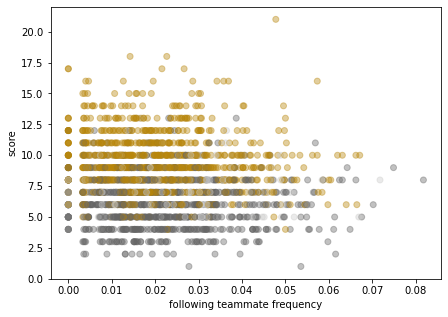

In [9]:
# Plot behavior frequency per game against scores and wins
from matplotlib.colors import LinearSegmentedColormap
cmap = LinearSegmentedColormap.from_list('', ['.4', '.8', 'darkgoldenrod'])

n_samples = 4501
behav_freq = np.sum(behavior, axis=3)[..., [0, 2], 0] / n_samples
fig, ax = plt.subplots(figsize=(7, 5))
ax.scatter(behav_freq.ravel(), scores.ravel(), c=wins_draw.ravel(), alpha=.4, cmap=cmap)
ax.set(ylabel='score', xlabel=f'{behavior_name} frequency');

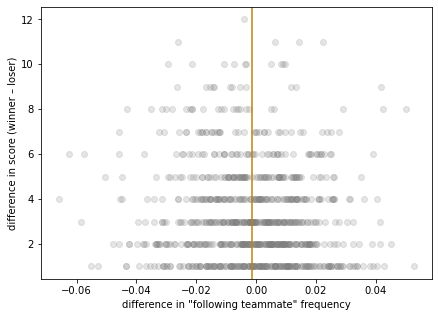

In [10]:
# Plot game-by-game difference in score against difference in behavior frequency
score_diff = scores[..., 0].ravel() - scores[..., 1].ravel()
score_sign = np.sign(score_diff)

non_ties = np.where(score_sign != 0)[0]

behav_diff = behav_freq[..., 0].ravel() - behav_freq[..., 1].ravel()
behav_win = behav_diff * score_sign

fig, ax = plt.subplots(figsize=(7, 5))
ax.scatter(behav_win[non_ties], np.abs(score_diff)[non_ties], c='.5', alpha=.2)
ax.set(xlabel=f'difference in "{behavior_name}" frequency',
       ylabel=f'difference in score (winner – loser)')
ax.axvline(np.mean(behav_win[non_ties]), c='darkgoldenrod');

In [11]:
# Print out some basic statistics
from scipy.stats import pearsonr, ttest_1samp

score_r, score_p = pearsonr(scores.ravel(), behav_freq.ravel())
print(f'correlation between score and behavior frequency: r = {score_r:.3f} (p = {score_p:.3f})')

win_t, win_p = ttest_1samp(behav_win[non_ties], popmean=0)
print(f'difference in behavior frequency for wins – losses: t = {win_t:.3f} (p = {win_p:.3f})')

correlation between score and behavior frequency: r = -0.069 (p = 0.002)
difference in behavior frequency for wins – losses: t = -2.561 (p = 0.011)


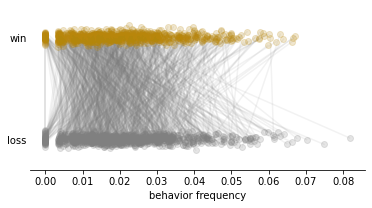

In [12]:
# Plot game-by-game behavior frequency for wins and losses
n_maps, n_repeats = 32, 32

freq_win, freq_loss = [], []
for map_id in np.arange(n_maps):
    for repeat_id in np.arange(n_repeats):
        if np.array_equal(wins_draw[map_id, repeat_id], [1, -1]):
            freq_win.append(behav_freq[map_id, repeat_id][0])
            freq_loss.append(behav_freq[map_id, repeat_id][1])
        elif np.array_equal(wins_draw[map_id, repeat_id], [-1, 1]):
            freq_win.append(behav_freq[map_id, repeat_id][1])
            freq_loss.append(behav_freq[map_id, repeat_id][0])

win_jitter = 1 + np.random.randn(len(freq_win)) / 30
loss_jitter = 0 + np.random.randn(len(freq_loss)) / 30

fig, ax = plt.subplots(figsize=(6, 3))
for i in np.arange(len(freq_win)):
    plt.plot([freq_win[i], freq_loss[i]],
             [win_jitter[i], loss_jitter[i]],
              c='.5', alpha=.1, zorder=-1)
plt.scatter(freq_win, win_jitter, alpha=.2, c='darkgoldenrod')
plt.scatter(freq_loss, loss_jitter, alpha=.2, c='.5')
ax.set(yticks=[0, 1], yticklabels=['loss', 'win'], ylim=(-.3, 1.3),
       xlabel='behavior frequency')
ax.tick_params(axis='y', which=u'both',length=0)
sns.despine(left=True)

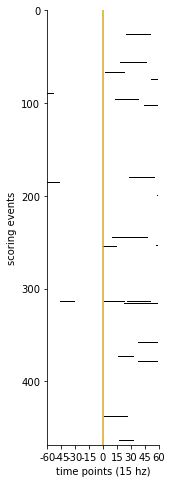

In [13]:
# Plot epochs for all scoring events across maps for a single repeat
repeat_id = 0
pad = (60, 60)
score_epochs = []
for map_id in np.arange(n_maps):
    score_epochs.extend(epoch_scores(wrap_f, behavior[map_id, repeat_id, [0, 2], :, 0],
                        pad=pad, map_id=map_id))

plot_epochs(np.vstack(score_epochs), pad=pad, ylabel='scoring events')

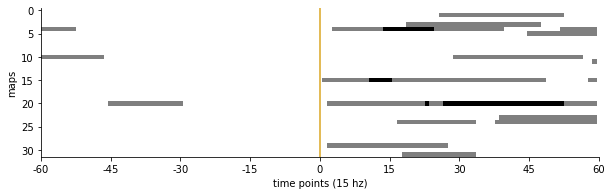

In [14]:
# Sum scoring epochs within maps for a given repeat
repeat_id = 0
pad = (60, 60)
score_epochs = []
for map_id in np.arange(n_maps):
    score_epochs.append(epoch_scores(wrap_f, behavior[map_id, repeat_id, [0, 2], :, 0],
                        pad=pad, map_id=map_id))

plot_epochs(np.vstack([np.sum(np.vstack(e), axis=0)
                       for e in score_epochs]), pad=pad, ylabel='maps')

/jukebox/hasson/snastase/miniconda3/envs/ctf/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: invalid value encountered in true_divide
  if sys.path[0] == '':


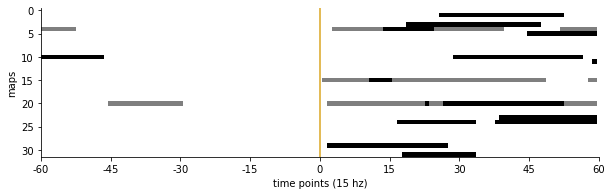

In [15]:
# Sum scoring epochs within maps for a given repeat (normalized)
repeat_id = 0
pad = (60, 60)
score_epochs = []
for map_id in np.arange(n_maps):
    score_epochs.append(epoch_scores(wrap_f, behavior[map_id, repeat_id, [0, 2], :, 0],
                        pad=pad, map_id=map_id))

plot_epochs(np.vstack([np.sum(np.vstack(e), axis=0)
                       for e in score_epochs]) /
            np.amax(np.vstack([np.sum(np.vstack(e), axis=0)
                       for e in score_epochs]), axis=1)[:, np.newaxis],
            pad=pad, ylabel='maps')

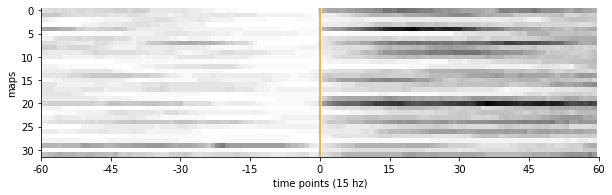

In [16]:
# Sum scoring epochs within maps across all repeats
pad = (60, 60)
score_epochs = []
for map_id in np.arange(n_maps):
    map_epochs = []
    for repeat_id in np.arange(n_repeats):
        map_epochs.extend(epoch_scores(wrap_f, behavior[map_id, repeat_id, [0, 2], :, 0],
                          pad=pad, map_id=map_id, repeat_id=repeat_id))
    score_epochs.append(np.sum(np.vstack(map_epochs), axis=0))

plot_epochs(np.vstack(score_epochs), pad=pad, ylabel='maps')

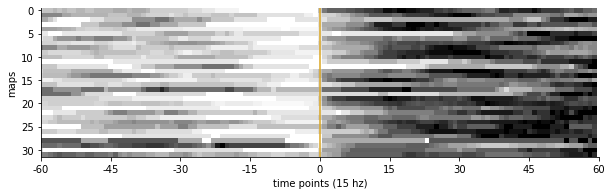

In [17]:
# Sum scoring epochs within maps across all repeats
pad = (60, 60)
score_epochs = []
for map_id in np.arange(n_maps):
    map_epochs = []
    for repeat_id in np.arange(n_repeats):
        map_epochs.extend(epoch_scores(wrap_f, behavior[map_id, repeat_id, [0, 2], :, 0],
                          pad=pad, map_id=map_id, repeat_id=repeat_id))
    score_epochs.append(np.sum(np.vstack(map_epochs), axis=0))

plot_epochs(np.vstack(score_epochs) / np.amax(np.vstack(score_epochs), axis=1)[:, np.newaxis],
            pad=pad, ylabel='maps')

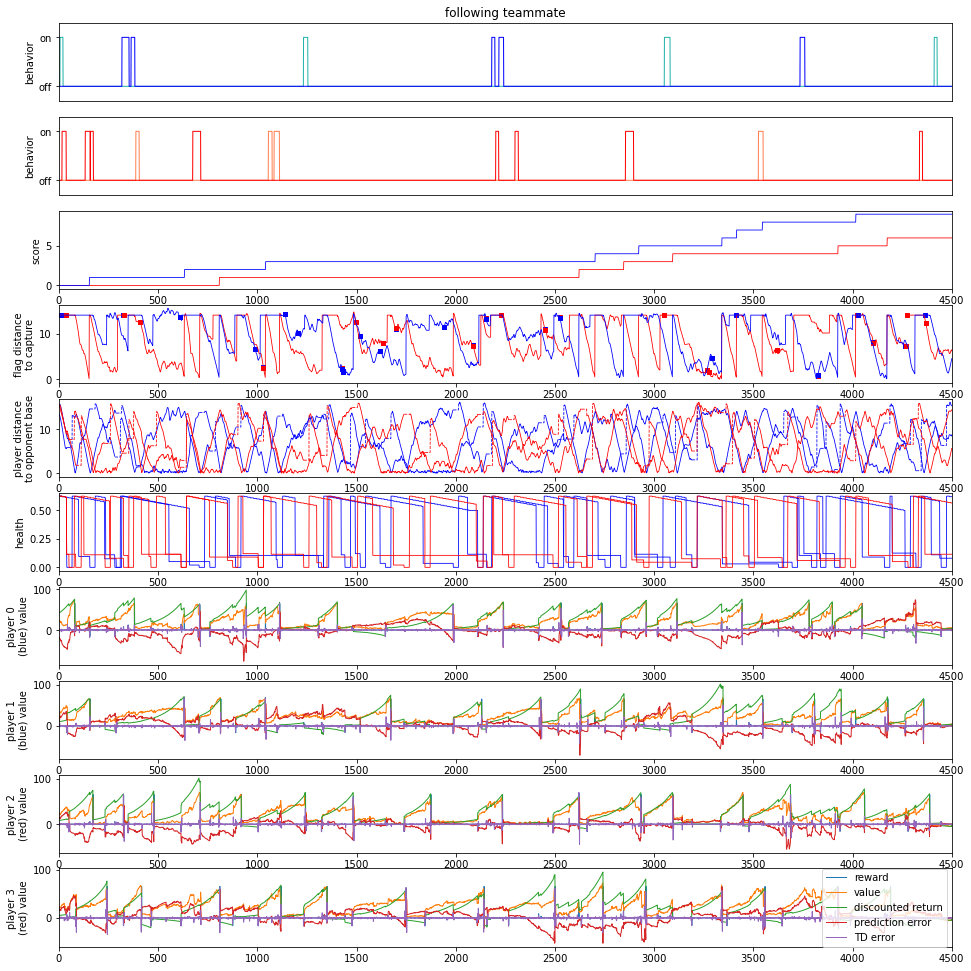

In [18]:
# Plot summary of behavior for one game
map_id, matchup_id, repeat_id = 0, 0, 0

behavior_game = behavior[map_id, repeat_id, ..., 0]

plot_behavior_summary(behavior_game, wrap_f, map_id=map_id,
                      matchup_id=matchup_id, repeat_id=repeat_id)

In [19]:
# Compute game-by-game difference in value when behavior is on/off
matchup_id = 0

on_value, off_value = [], []
diffs = []
for map_id in np.arange(n_maps):
    for repeat_id in np.arange(n_repeats):
        value = wrap_f['map/matchup/repeat/player/time/value'][
            map_id, matchup_id, repeat_id]
        on_mean = np.mean(value[behavior[map_id, repeat_id]])
        off_mean = np.mean(value[~behavior[map_id, repeat_id]])
        on_value.append(on_mean)
        off_value.append(off_mean)
        diff = (np.mean(value[behavior[map_id, repeat_id]]) - 
                np.mean(value[~behavior[map_id, repeat_id]]))
        diffs.append(diff)

# Compute player-by-player correlation between behavior and value
matchup_id = 0

value_r, value_p = (np.zeros((n_maps, n_repeats, 4)),
                    np.zeros((n_maps, n_repeats, 4)))
for map_id in np.arange(n_maps):
    for repeat_id in np.arange(n_repeats):
        for player_id in np.arange(4):
            value = wrap_f['map/matchup/repeat/player/time/value'][
                map_id, matchup_id, repeat_id, player_id]
            player_beh = behavior[map_id, repeat_id, player_id]
            r, p = pearsonr(value[:, 0], player_beh[:, 0])
            value_r[map_id, repeat_id, player_id] = r
            value_p[map_id, repeat_id, player_id] = p

corr_t, corr_p = ttest_1samp(np.nan_to_num(value_r.ravel()), popmean=0)
print(f'correlation between behavior indicator and value: {np.nanmean(value_r):.3f} '
      f'(t = {corr_t:.3f}, p = {corr_p:.3f})')

# Print out some basic statistics
value_t, value_p = ttest_1samp(diffs, popmean=0)
print(f'difference in value for behavior on – off: t = {value_t:.3f} (p = {value_p:.3f})')

/jukebox/hasson/snastase/miniconda3/envs/ctf/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


correlation between behavior indicator and value: 0.010 (t = 14.503, p = 0.000)
difference in value for behavior on – off: t = 15.495 (p = 0.000)


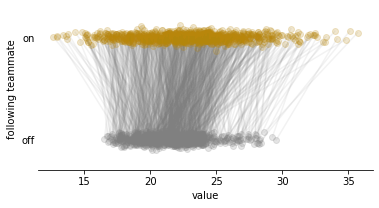

In [20]:
# Plot game-by-game difference in value for behavior on/off
on_jitter = 1 + np.random.randn(len(on_value)) / 30
off_jitter = 0 + np.random.randn(len(off_value)) / 30

fig, ax = plt.subplots(figsize=(6, 3))
for i in np.arange(len(on_value)):
    plt.plot([on_value[i], off_value[i]],
             [on_jitter[i], off_jitter[i]],
              c='.5', alpha=.1, zorder=-1)
plt.scatter(on_value, on_jitter, c='darkgoldenrod', alpha=.2)
plt.scatter(off_value, off_jitter, c='.5', alpha=.2)
ax.set(yticks=[0, 1], yticklabels=['off', 'on'], ylim=(-.3, 1.3),
       xlabel='value', ylabel=f'{behavior_name}')
ax.tick_params(axis='y', which=u'both',length=0)
sns.despine(left=True)

## Assist
* Alive
* Teammate alive
* Teammate has opponent flag
* Own flag is stray or opponent has flag
* Approaching own flag
* Within radius of own flag
* For a sustained period of time

In [21]:
# Load in following behavior
from behavior_heuristics import assist
behavior_name = 'assist'

map_id, repeat_id = slice(None), slice(None) # 0, 0
matchup_id, player_id = 0, slice(None)
min_behavior_length = 15
min_approach = 0
own_flag_radius = 4

behavior = assist(wrap_f, map_id=map_id, matchup_id=matchup_id,
    repeat_id=repeat_id, player_id=player_id, min_behavior_length=min_behavior_length,
    min_approach=min_approach, own_flag_radius=own_flag_radius)

print(f"{behavior_name} frequency: {np.sum(behavior) / behavior.size:.3f}")

assist frequency: 0.041


In [22]:
# Create video of behavior in example game
filename = f"figures/{behavior_name.replace(' ', '_')}_topdown_ts.mp4"

map_id, matchup_id, repeat_id = 0, 0, 0

behavior_game = behavior[map_id, repeat_id, ..., 0] # behavior[..., 0]
event_video_path = time_series_top(behavior_game, wrap_f, map_id=map_id,
                                   matchup_id=matchup_id, repeat_id=repeat_id,
                                   label=behavior_name,
                                   filename=filename)
Video(filename, embed=True)

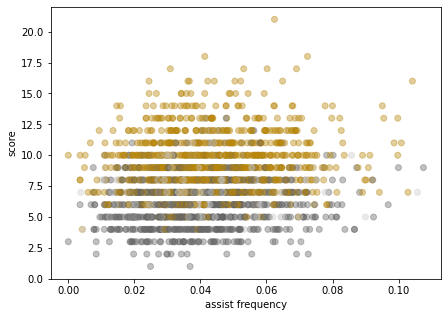

In [23]:
# Plot behavior frequency per game against scores and wins
from matplotlib.colors import LinearSegmentedColormap
cmap = LinearSegmentedColormap.from_list('', ['.4', '.8', 'darkgoldenrod'])

n_samples = 4501
behav_freq = np.sum(behavior, axis=3)[..., [0, 2], 0] / n_samples
fig, ax = plt.subplots(figsize=(7, 5))
ax.scatter(behav_freq.ravel(), scores.ravel(), c=wins_draw.ravel(), alpha=.4, cmap=cmap)
ax.set(ylabel='score', xlabel=f'{behavior_name} frequency');

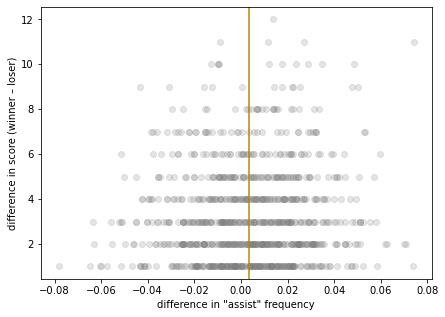

In [24]:
# Plot game-by-game difference in score against difference in behavior frequency
score_diff = scores[..., 0].ravel() - scores[..., 1].ravel()
score_sign = np.sign(score_diff)

non_ties = np.where(score_sign != 0)[0]

behav_diff = behav_freq[..., 0].ravel() - behav_freq[..., 1].ravel()
behav_win = behav_diff * score_sign

fig, ax = plt.subplots(figsize=(7, 5))
ax.scatter(behav_win[non_ties], np.abs(score_diff)[non_ties], c='.5', alpha=.2)
ax.set(xlabel=f'difference in "{behavior_name}" frequency',
       ylabel=f'difference in score (winner – loser)')
ax.axvline(np.mean(behav_win[non_ties]), c='darkgoldenrod');

In [25]:
# Print out some basic statistics
from scipy.stats import pearsonr, ttest_1samp

score_r, score_p = pearsonr(scores.ravel(), behav_freq.ravel())
print(f'correlation between score and behavior frequency: r = {score_r:.3f} (p = {score_p:.3f})')

win_t, win_p = ttest_1samp(behav_win[non_ties], popmean=0)
print(f'difference in behavior frequency for wins – losses: t = {win_t:.3f} (p = {win_p:.3f})')

correlation between score and behavior frequency: r = 0.141 (p = 0.000)
difference in behavior frequency for wins – losses: t = 4.478 (p = 0.000)


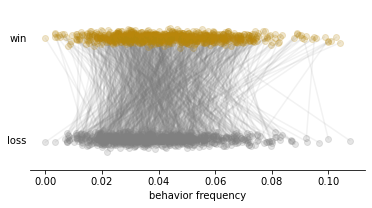

In [26]:
# Plot game-by-game behavior frequency for wins and losses
n_maps, n_repeats = 32, 32

freq_win, freq_loss = [], []
for map_id in np.arange(n_maps):
    for repeat_id in np.arange(n_repeats):
        if np.array_equal(wins_draw[map_id, repeat_id], [1, -1]):
            freq_win.append(behav_freq[map_id, repeat_id][0])
            freq_loss.append(behav_freq[map_id, repeat_id][1])
        elif np.array_equal(wins_draw[map_id, repeat_id], [-1, 1]):
            freq_win.append(behav_freq[map_id, repeat_id][1])
            freq_loss.append(behav_freq[map_id, repeat_id][0])

win_jitter = 1 + np.random.randn(len(freq_win)) / 30
loss_jitter = 0 + np.random.randn(len(freq_loss)) / 30

fig, ax = plt.subplots(figsize=(6, 3))
for i in np.arange(len(freq_win)):
    plt.plot([freq_win[i], freq_loss[i]],
             [win_jitter[i], loss_jitter[i]],
              c='.5', alpha=.1, zorder=-1)
plt.scatter(freq_win, win_jitter, alpha=.2, c='darkgoldenrod')
plt.scatter(freq_loss, loss_jitter, alpha=.2, c='.5')
ax.set(yticks=[0, 1], yticklabels=['loss', 'win'], ylim=(-.3, 1.3),
       xlabel='behavior frequency')
ax.tick_params(axis='y', which=u'both',length=0)
sns.despine(left=True)

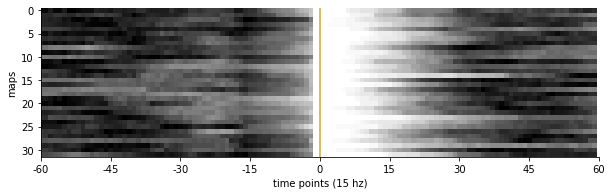

In [27]:
# Sum scoring epochs within maps across all repeats
pad = (60, 60)
score_epochs = []
for map_id in np.arange(n_maps):
    map_epochs = []
    for repeat_id in np.arange(n_repeats):
        map_epochs.extend(epoch_scores(wrap_f, behavior[map_id, repeat_id, [0, 2], :, 0],
                          pad=pad, map_id=map_id, repeat_id=repeat_id))
    score_epochs.append(np.sum(np.vstack(map_epochs), axis=0))

plot_epochs(np.vstack(score_epochs) / np.amax(np.vstack(score_epochs), axis=1)[:, np.newaxis],
            pad=pad, ylabel='maps')

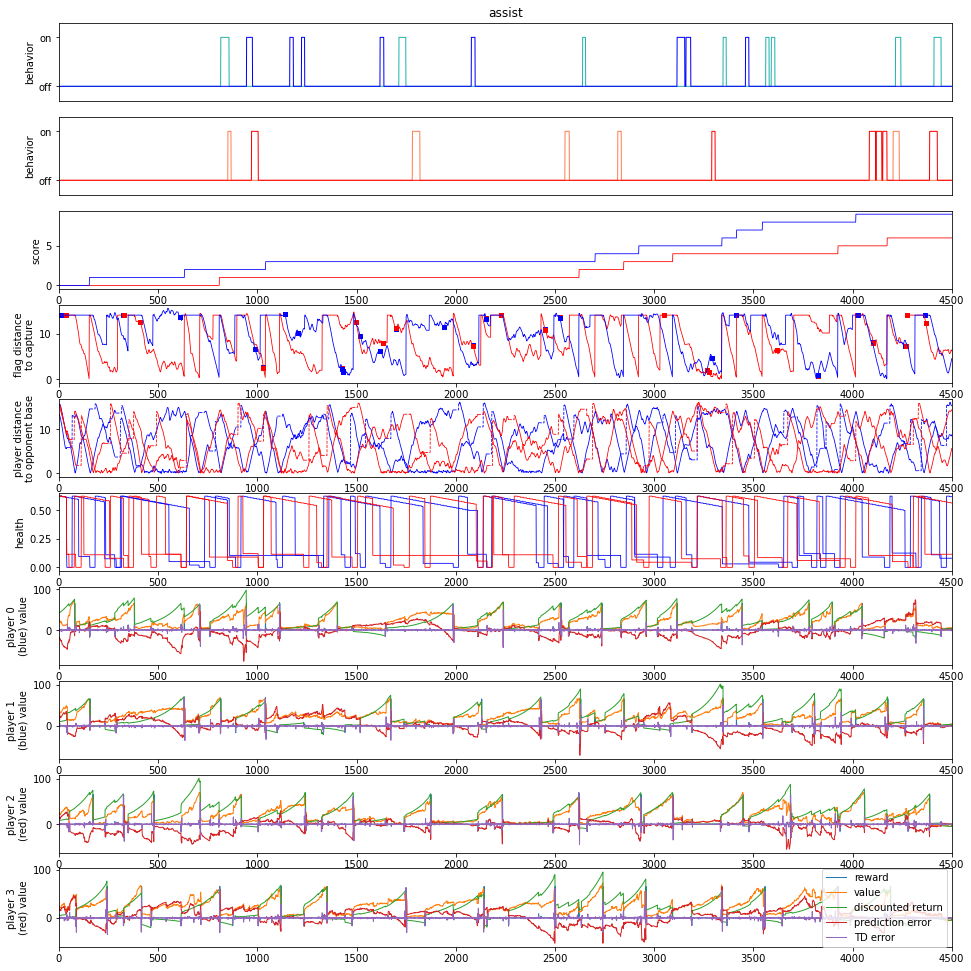

In [28]:
# Plot summary of behavior for one game
map_id, matchup_id, repeat_id = 0, 0, 0

behavior_game = behavior[map_id, repeat_id, ..., 0]

plot_behavior_summary(behavior_game, wrap_f, map_id=map_id,
                      matchup_id=matchup_id, repeat_id=repeat_id)

In [29]:
# Compute game-by-game difference in value when behavior is on/off
matchup_id = 0

on_value, off_value = [], []
diffs = []
for map_id in np.arange(n_maps):
    for repeat_id in np.arange(n_repeats):
        value = wrap_f['map/matchup/repeat/player/time/value'][
            map_id, matchup_id, repeat_id]
        on_mean = np.mean(value[behavior[map_id, repeat_id]])
        off_mean = np.mean(value[~behavior[map_id, repeat_id]])
        on_value.append(on_mean)
        off_value.append(off_mean)
        diff = (np.mean(value[behavior[map_id, repeat_id]]) - 
                np.mean(value[~behavior[map_id, repeat_id]]))
        diffs.append(diff)

# Compute player-by-player correlation between behavior and value
matchup_id = 0

value_r, value_p = (np.zeros((n_maps, n_repeats, 4)),
                    np.zeros((n_maps, n_repeats, 4)))
for map_id in np.arange(n_maps):
    for repeat_id in np.arange(n_repeats):
        for player_id in np.arange(4):
            value = wrap_f['map/matchup/repeat/player/time/value'][
                map_id, matchup_id, repeat_id, player_id]
            player_beh = behavior[map_id, repeat_id, player_id]
            r, p = pearsonr(value[:, 0], player_beh[:, 0])
            value_r[map_id, repeat_id, player_id] = r
            value_p[map_id, repeat_id, player_id] = p

corr_t, corr_p = ttest_1samp(np.nan_to_num(value_r.ravel()), popmean=0)
print(f'correlation between behavior indicator and value: {np.nanmean(value_r):.3f} '
      f'(t = {corr_t:.3f}, p = {corr_p:.3f})')

# Print out some basic statistics
value_t, value_p = ttest_1samp(diffs, popmean=0)
print(f'difference in value for behavior on – off: t = {value_t:.3f} (p = {value_p:.3f})')

/jukebox/hasson/snastase/miniconda3/envs/ctf/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


correlation between behavior indicator and value: 0.099 (t = 122.014, p = 0.000)
difference in value for behavior on – off: t = 111.064 (p = 0.000)


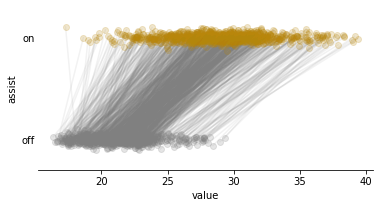

In [30]:
# Plot game-by-game difference in value for behavior on/off
on_jitter = 1 + np.random.randn(len(on_value)) / 30
off_jitter = 0 + np.random.randn(len(off_value)) / 30

fig, ax = plt.subplots(figsize=(6, 3))
for i in np.arange(len(on_value)):
    plt.plot([on_value[i], off_value[i]],
             [on_jitter[i], off_jitter[i]],
              c='.5', alpha=.1, zorder=-1)
plt.scatter(on_value, on_jitter, c='darkgoldenrod', alpha=.2)
plt.scatter(off_value, off_jitter, c='.5', alpha=.2)
ax.set(yticks=[0, 1], yticklabels=['off', 'on'], ylim=(-.3, 1.3),
       xlabel='value', ylabel=f'{behavior_name}')
ax.tick_params(axis='y', which=u'both',length=0)
sns.despine(left=True)

## Escort
* Alive
* Teammate alive
* Near teammate
* Teammate has flag
* For a sustained period of time

In [31]:
# Load in following behavior
from behavior_heuristics import escort
behavior_name = 'escort'

map_id, repeat_id = slice(None), slice(None) # 0, 0
matchup_id, player_id = 0, slice(None)
min_behavior_length = 30
teammate_radius = 3

behavior = escort(wrap_f, map_id=map_id, matchup_id=matchup_id,
    repeat_id=repeat_id, player_id=player_id, min_behavior_length=min_behavior_length,
    teammate_radius=teammate_radius)

print(f"{behavior_name} frequency: {np.sum(behavior) / behavior.size:.3f}")

escort frequency: 0.012


In [32]:
# Create video of behavior in example game
filename = f"figures/{behavior_name.replace(' ', '_')}_topdown_ts.mp4"

map_id, matchup_id, repeat_id = 0, 0, 0

behavior_game = behavior[map_id, repeat_id, ..., 0] # behavior[..., 0]
event_video_path = time_series_top(behavior_game, wrap_f, map_id=map_id,
                                   matchup_id=matchup_id, repeat_id=repeat_id,
                                   label=behavior_name,
                                   filename=filename)
Video(filename, embed=True)

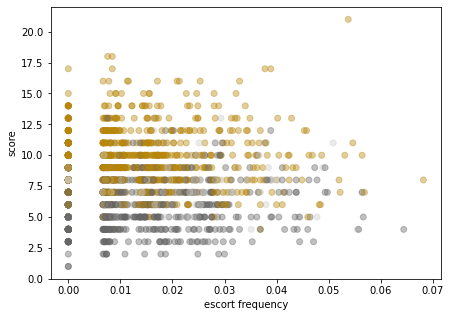

In [33]:
# Plot behavior frequency per game against scores and wins
from matplotlib.colors import LinearSegmentedColormap
cmap = LinearSegmentedColormap.from_list('', ['.4', '.8', 'darkgoldenrod'])

n_samples = 4501
behav_freq = np.sum(behavior, axis=3)[..., [0, 2], 0] / n_samples
fig, ax = plt.subplots(figsize=(7, 5))
ax.scatter(behav_freq.ravel(), scores.ravel(), c=wins_draw.ravel(), alpha=.4, cmap=cmap)
ax.set(ylabel='score', xlabel=f'{behavior_name} frequency');

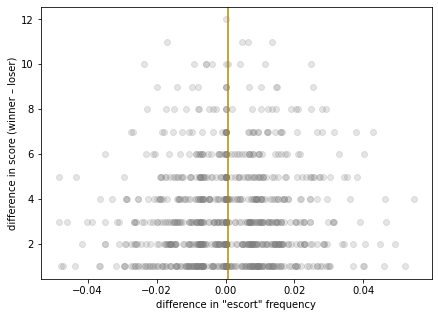

In [34]:
# Plot game-by-game difference in score against difference in behavior frequency
score_diff = scores[..., 0].ravel() - scores[..., 1].ravel()
score_sign = np.sign(score_diff)

non_ties = np.where(score_sign != 0)[0]

behav_diff = behav_freq[..., 0].ravel() - behav_freq[..., 1].ravel()
behav_win = behav_diff * score_sign

fig, ax = plt.subplots(figsize=(7, 5))
ax.scatter(behav_win[non_ties], np.abs(score_diff)[non_ties], c='.5', alpha=.2)
ax.set(xlabel=f'difference in "{behavior_name}" frequency',
       ylabel=f'difference in score (winner – loser)')
ax.axvline(np.mean(behav_win[non_ties]), c='darkgoldenrod');

In [35]:
# Print out some basic statistics
from scipy.stats import pearsonr, ttest_1samp

score_r, score_p = pearsonr(scores.ravel(), behav_freq.ravel())
print(f'correlation between score and behavior frequency: r = {score_r:.3f} (p = {score_p:.3f})')

win_t, win_p = ttest_1samp(behav_win[non_ties], popmean=0)
print(f'difference in behavior frequency for wins – losses: t = {win_t:.3f} (p = {win_p:.3f})')

correlation between score and behavior frequency: r = 0.051 (p = 0.020)
difference in behavior frequency for wins – losses: t = 1.520 (p = 0.129)


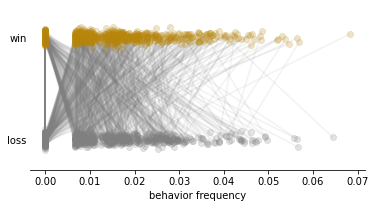

In [36]:
# Plot game-by-game behavior frequency for wins and losses
n_maps, n_repeats = 32, 32

freq_win, freq_loss = [], []
for map_id in np.arange(n_maps):
    for repeat_id in np.arange(n_repeats):
        if np.array_equal(wins_draw[map_id, repeat_id], [1, -1]):
            freq_win.append(behav_freq[map_id, repeat_id][0])
            freq_loss.append(behav_freq[map_id, repeat_id][1])
        elif np.array_equal(wins_draw[map_id, repeat_id], [-1, 1]):
            freq_win.append(behav_freq[map_id, repeat_id][1])
            freq_loss.append(behav_freq[map_id, repeat_id][0])

win_jitter = 1 + np.random.randn(len(freq_win)) / 30
loss_jitter = 0 + np.random.randn(len(freq_loss)) / 30

fig, ax = plt.subplots(figsize=(6, 3))
for i in np.arange(len(freq_win)):
    plt.plot([freq_win[i], freq_loss[i]],
             [win_jitter[i], loss_jitter[i]],
              c='.5', alpha=.1, zorder=-1)
plt.scatter(freq_win, win_jitter, alpha=.2, c='darkgoldenrod')
plt.scatter(freq_loss, loss_jitter, alpha=.2, c='.5')
ax.set(yticks=[0, 1], yticklabels=['loss', 'win'], ylim=(-.3, 1.3),
       xlabel='behavior frequency')
ax.tick_params(axis='y', which=u'both',length=0)
sns.despine(left=True)

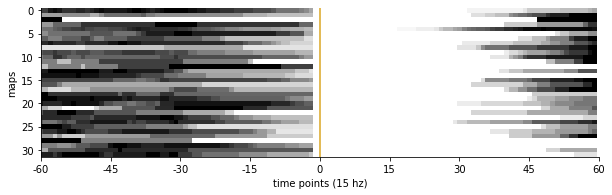

In [37]:
# Sum scoring epochs within maps across all repeats
pad = (60, 60)
score_epochs = []
for map_id in np.arange(n_maps):
    map_epochs = []
    for repeat_id in np.arange(n_repeats):
        map_epochs.extend(epoch_scores(wrap_f, behavior[map_id, repeat_id, [0, 2], :, 0],
                          pad=pad, map_id=map_id, repeat_id=repeat_id))
    score_epochs.append(np.sum(np.vstack(map_epochs), axis=0))

plot_epochs(np.vstack(score_epochs) / np.amax(np.vstack(score_epochs), axis=1)[:, np.newaxis],
            pad=pad, ylabel='maps')

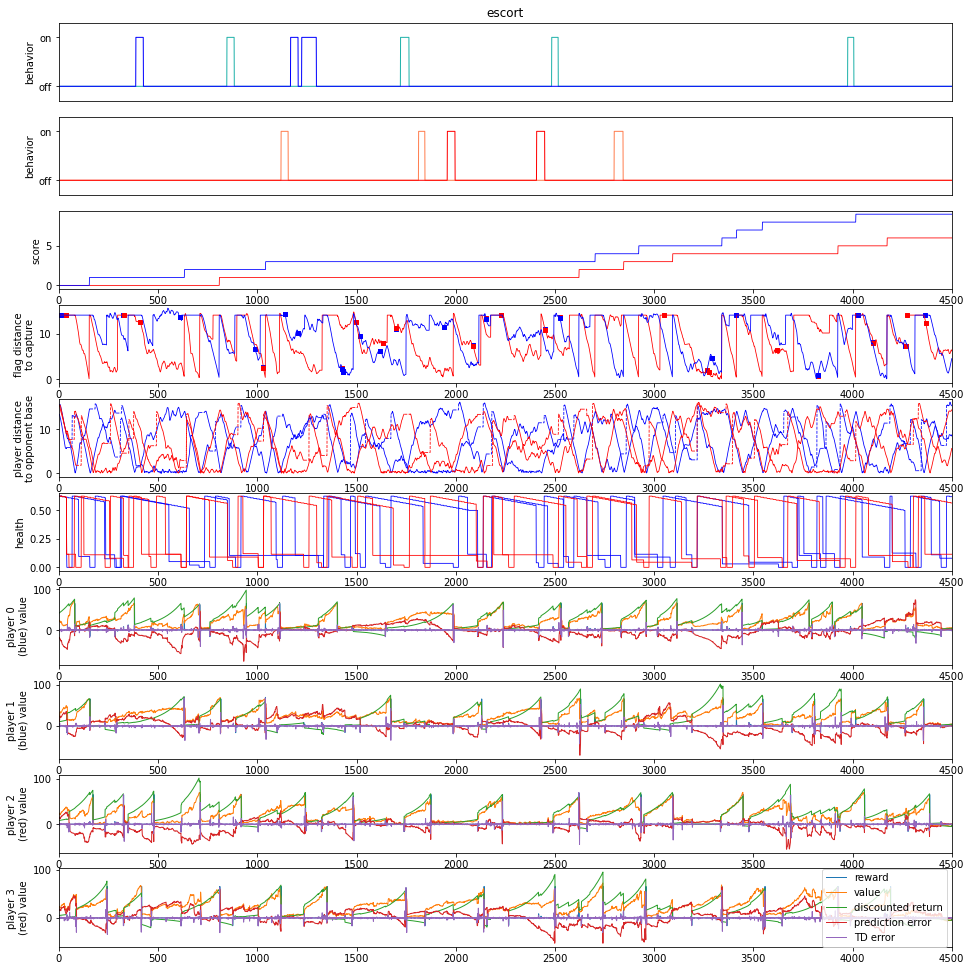

In [38]:
# Plot summary of behavior for one game
map_id, matchup_id, repeat_id = 0, 0, 0

behavior_game = behavior[map_id, repeat_id, ..., 0]

plot_behavior_summary(behavior_game, wrap_f, map_id=map_id,
                      matchup_id=matchup_id, repeat_id=repeat_id)

In [39]:
# Compute game-by-game difference in value when behavior is on/off
matchup_id = 0

on_value, off_value = [], []
diffs = []
for map_id in np.arange(n_maps):
    for repeat_id in np.arange(n_repeats):
        value = wrap_f['map/matchup/repeat/player/time/value'][
            map_id, matchup_id, repeat_id]
        on_mean = np.mean(value[behavior[map_id, repeat_id]])
        off_mean = np.mean(value[~behavior[map_id, repeat_id]])
        on_value.append(on_mean)
        off_value.append(off_mean)
        diff = (np.mean(value[behavior[map_id, repeat_id]]) - 
                np.mean(value[~behavior[map_id, repeat_id]]))
        diffs.append(diff)

# Compute player-by-player correlation between behavior and value
matchup_id = 0

value_r, value_p = (np.zeros((n_maps, n_repeats, 4)),
                    np.zeros((n_maps, n_repeats, 4)))
for map_id in np.arange(n_maps):
    for repeat_id in np.arange(n_repeats):
        for player_id in np.arange(4):
            value = wrap_f['map/matchup/repeat/player/time/value'][
                map_id, matchup_id, repeat_id, player_id]
            player_beh = behavior[map_id, repeat_id, player_id]
            r, p = pearsonr(value[:, 0], player_beh[:, 0])
            value_r[map_id, repeat_id, player_id] = r
            value_p[map_id, repeat_id, player_id] = p

corr_t, corr_p = ttest_1samp(np.nan_to_num(value_r.ravel()), popmean=0)
print(f'correlation between behavior indicator and value: {np.nanmean(value_r):.3f} '
      f'(t = {corr_t:.3f}, p = {corr_p:.3f})')

# Print out some basic statistics
value_t, value_p = ttest_1samp(np.nan_to_num(diffs), popmean=0)
print(f'difference in value for behavior on – off: t = {value_t:.3f} (p = {value_p:.3f})')

/jukebox/hasson/snastase/miniconda3/envs/ctf/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/jukebox/hasson/snastase/miniconda3/envs/ctf/lib/python3.7/site-packages/numpy/core/_methods.py:168: RuntimeWarning: invalid value encountered in true_divide
  ret = arr.dtype.type(ret / rcount)
/jukebox/hasson/snastase/miniconda3/envs/ctf/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


correlation between behavior indicator and value: 0.038 (t = 41.302, p = 0.000)
difference in value for behavior on – off: t = 39.434 (p = 0.000)


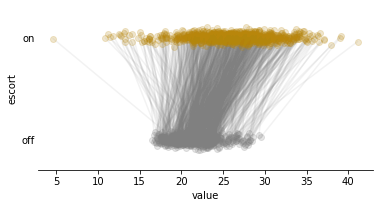

In [40]:
# Plot game-by-game difference in value for behavior on/off
on_jitter = 1 + np.random.randn(len(on_value)) / 30
off_jitter = 0 + np.random.randn(len(off_value)) / 30

fig, ax = plt.subplots(figsize=(6, 3))
for i in np.arange(len(on_value)):
    plt.plot([on_value[i], off_value[i]],
             [on_jitter[i], off_jitter[i]],
              c='.5', alpha=.1, zorder=-1)
plt.scatter(on_value, on_jitter, c='darkgoldenrod', alpha=.2)
plt.scatter(off_value, off_jitter, c='.5', alpha=.2)
ax.set(yticks=[0, 1], yticklabels=['off', 'on'], ylim=(-.3, 1.3),
       xlabel='value', ylabel=f'{behavior_name}')
ax.tick_params(axis='y', which=u'both',length=0)
sns.despine(left=True)

## Spawn camping
* Alive
* Near opponent base
* Opponent flag away from opponent base
* For a sustained period of time

In [41]:
# Load in following behavior
from behavior_heuristics import spawn_camping
behavior_name = 'spawn camping'

map_id, repeat_id = slice(None), slice(None) # 0, 0
matchup_id, player_id = 0, slice(None)
min_behavior_length = 15
base_radius = 1
flag_base_radius = 2

behavior = spawn_camping(wrap_f, map_id=map_id, matchup_id=matchup_id,
    repeat_id=repeat_id, player_id=player_id, min_behavior_length=min_behavior_length,
    base_radius=base_radius, flag_base_radius=flag_base_radius)

print(f"{behavior_name} frequency: {np.sum(behavior) / behavior.size:.3f}")

spawn camping frequency: 0.005


In [42]:
# Create video of behavior in example game
filename = f"figures/{behavior_name.replace(' ', '_')}_topdown_ts.mp4"

map_id, matchup_id, repeat_id = 0, 0, 0

behavior_game = behavior[map_id, repeat_id, ..., 0] # behavior[..., 0]
event_video_path = time_series_top(behavior_game, wrap_f, map_id=map_id,
                                   matchup_id=matchup_id, repeat_id=repeat_id,
                                   label=behavior_name,
                                   filename=filename)
Video(filename, embed=True)

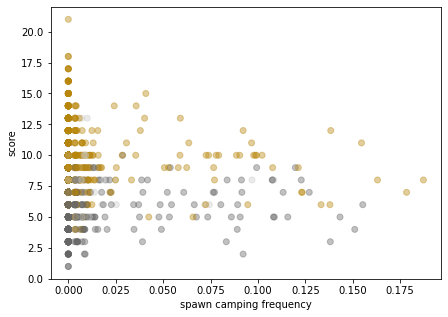

In [43]:
# Plot behavior frequency per game against scores and wins
from matplotlib.colors import LinearSegmentedColormap
cmap = LinearSegmentedColormap.from_list('', ['.4', '.8', 'darkgoldenrod'])

n_samples = 4501
behav_freq = np.sum(behavior, axis=3)[..., [0, 2], 0] / n_samples
fig, ax = plt.subplots(figsize=(7, 5))
ax.scatter(behav_freq.ravel(), scores.ravel(), c=wins_draw.ravel(), alpha=.4, cmap=cmap)
ax.set(ylabel='score', xlabel=f'{behavior_name} frequency');

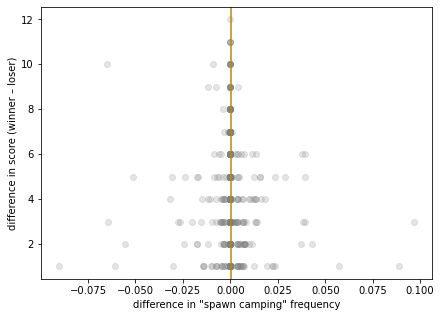

In [44]:
# Plot game-by-game difference in score against difference in behavior frequency
score_diff = scores[..., 0].ravel() - scores[..., 1].ravel()
score_sign = np.sign(score_diff)

non_ties = np.where(score_sign != 0)[0]

behav_diff = behav_freq[..., 0].ravel() - behav_freq[..., 1].ravel()
behav_win = behav_diff * score_sign

fig, ax = plt.subplots(figsize=(7, 5))
ax.scatter(behav_win[non_ties], np.abs(score_diff)[non_ties], c='.5', alpha=.2)
ax.set(xlabel=f'difference in "{behavior_name}" frequency',
       ylabel=f'difference in score (winner – loser)')
ax.axvline(np.mean(behav_win[non_ties]), c='darkgoldenrod');

In [45]:
# Print out some basic statistics
from scipy.stats import pearsonr, ttest_1samp

score_r, score_p = pearsonr(scores.ravel(), behav_freq.ravel())
print(f'correlation between score and behavior frequency: r = {score_r:.3f} (p = {score_p:.3f})')

win_t, win_p = ttest_1samp(behav_win[non_ties], popmean=0)
print(f'difference in behavior frequency for wins – losses: t = {win_t:.3f} (p = {win_p:.3f})')

correlation between score and behavior frequency: r = -0.020 (p = 0.354)
difference in behavior frequency for wins – losses: t = 0.503 (p = 0.615)


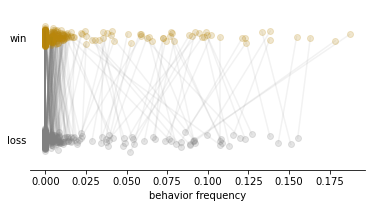

In [46]:
# Plot game-by-game behavior frequency for wins and losses
n_maps, n_repeats = 32, 32

freq_win, freq_loss = [], []
for map_id in np.arange(n_maps):
    for repeat_id in np.arange(n_repeats):
        if np.array_equal(wins_draw[map_id, repeat_id], [1, -1]):
            freq_win.append(behav_freq[map_id, repeat_id][0])
            freq_loss.append(behav_freq[map_id, repeat_id][1])
        elif np.array_equal(wins_draw[map_id, repeat_id], [-1, 1]):
            freq_win.append(behav_freq[map_id, repeat_id][1])
            freq_loss.append(behav_freq[map_id, repeat_id][0])

win_jitter = 1 + np.random.randn(len(freq_win)) / 30
loss_jitter = 0 + np.random.randn(len(freq_loss)) / 30

fig, ax = plt.subplots(figsize=(6, 3))
for i in np.arange(len(freq_win)):
    plt.plot([freq_win[i], freq_loss[i]],
             [win_jitter[i], loss_jitter[i]],
              c='.5', alpha=.1, zorder=-1)
plt.scatter(freq_win, win_jitter, alpha=.2, c='darkgoldenrod')
plt.scatter(freq_loss, loss_jitter, alpha=.2, c='.5')
ax.set(yticks=[0, 1], yticklabels=['loss', 'win'], ylim=(-.3, 1.3),
       xlabel='behavior frequency')
ax.tick_params(axis='y', which=u'both',length=0)
sns.despine(left=True)

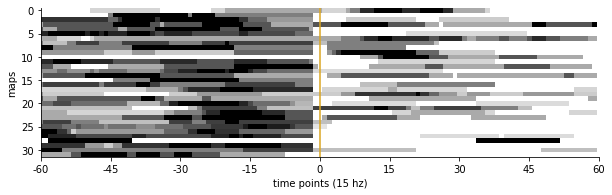

In [47]:
# Sum scoring epochs within maps across all repeats
pad = (60, 60)
score_epochs = []
for map_id in np.arange(n_maps):
    map_epochs = []
    for repeat_id in np.arange(n_repeats):
        map_epochs.extend(epoch_scores(wrap_f, behavior[map_id, repeat_id, [0, 2], :, 0],
                          pad=pad, map_id=map_id, repeat_id=repeat_id))
    score_epochs.append(np.sum(np.vstack(map_epochs), axis=0))

plot_epochs(np.vstack(score_epochs) / np.amax(np.vstack(score_epochs), axis=1)[:, np.newaxis],
            pad=pad, ylabel='maps')

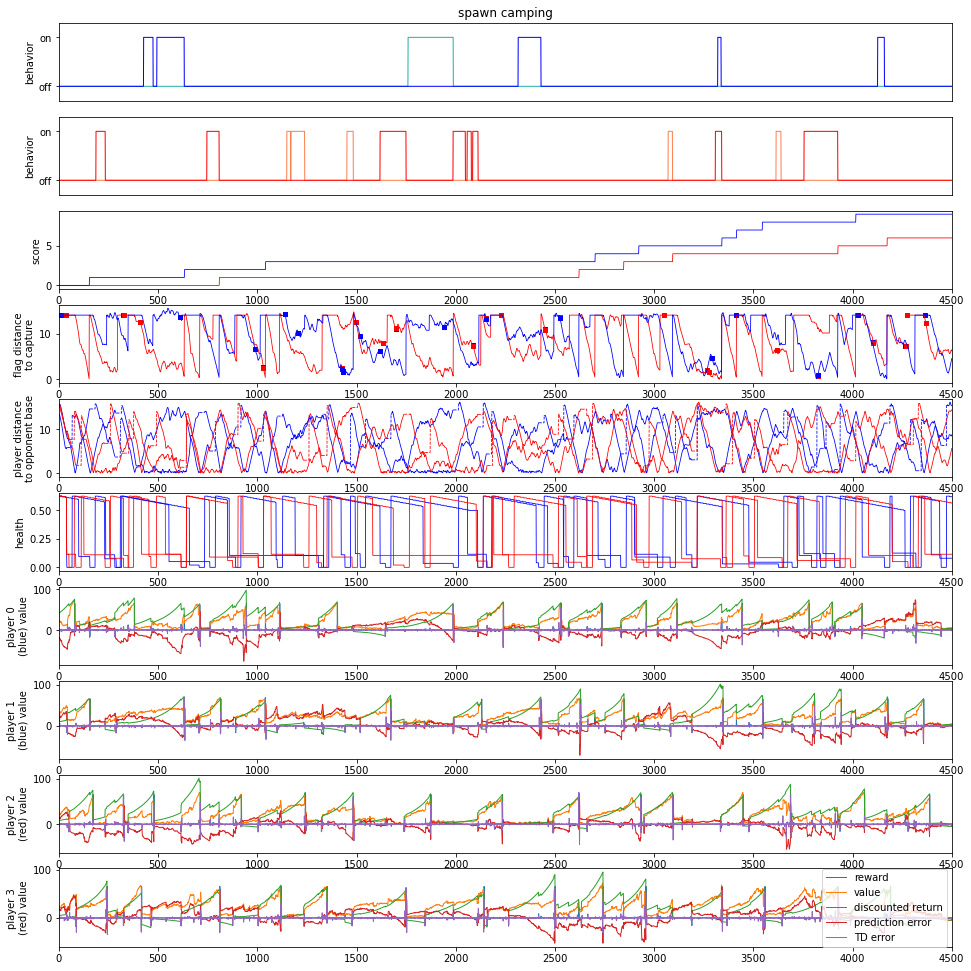

In [48]:
# Plot summary of behavior for one game
map_id, matchup_id, repeat_id = 0, 0, 0

behavior_game = behavior[map_id, repeat_id, ..., 0]

plot_behavior_summary(behavior_game, wrap_f, map_id=map_id,
                      matchup_id=matchup_id, repeat_id=repeat_id)

In [49]:
# Compute game-by-game difference in value when behavior is on/off
matchup_id = 0

on_value, off_value = [], []
diffs = []
for map_id in np.arange(n_maps):
    for repeat_id in np.arange(n_repeats):
        value = wrap_f['map/matchup/repeat/player/time/value'][
            map_id, matchup_id, repeat_id]
        on_mean = np.mean(value[behavior[map_id, repeat_id]])
        off_mean = np.mean(value[~behavior[map_id, repeat_id]])
        on_value.append(on_mean)
        off_value.append(off_mean)
        diff = (np.mean(value[behavior[map_id, repeat_id]]) - 
                np.mean(value[~behavior[map_id, repeat_id]]))
        diffs.append(diff)

# Compute player-by-player correlation between behavior and value
matchup_id = 0

value_r, value_p = (np.zeros((n_maps, n_repeats, 4)),
                    np.zeros((n_maps, n_repeats, 4)))
for map_id in np.arange(n_maps):
    for repeat_id in np.arange(n_repeats):
        for player_id in np.arange(4):
            value = wrap_f['map/matchup/repeat/player/time/value'][
                map_id, matchup_id, repeat_id, player_id]
            player_beh = behavior[map_id, repeat_id, player_id]
            r, p = pearsonr(value[:, 0], player_beh[:, 0])
            value_r[map_id, repeat_id, player_id] = r
            value_p[map_id, repeat_id, player_id] = p

corr_t, corr_p = ttest_1samp(np.nan_to_num(value_r.ravel()), popmean=0)
print(f'correlation between behavior indicator and value: {np.nanmean(value_r):.3f} '
      f'(t = {corr_t:.3f}, p = {corr_p:.3f})')

# Print out some basic statistics
value_t, value_p = ttest_1samp(np.nan_to_num(diffs), popmean=0)
print(f'difference in value for behavior on – off: t = {value_t:.3f} (p = {value_p:.3f})')

/jukebox/hasson/snastase/miniconda3/envs/ctf/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/jukebox/hasson/snastase/miniconda3/envs/ctf/lib/python3.7/site-packages/numpy/core/_methods.py:168: RuntimeWarning: invalid value encountered in true_divide
  ret = arr.dtype.type(ret / rcount)
/jukebox/hasson/snastase/miniconda3/envs/ctf/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


correlation between behavior indicator and value: 0.091 (t = 15.794, p = 0.000)
difference in value for behavior on – off: t = 9.752 (p = 0.000)


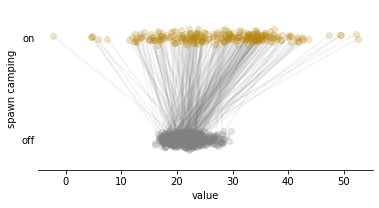

In [50]:
# Plot game-by-game difference in value for behavior on/off
on_jitter = 1 + np.random.randn(len(on_value)) / 30
off_jitter = 0 + np.random.randn(len(off_value)) / 30

fig, ax = plt.subplots(figsize=(6, 3))
for i in np.arange(len(on_value)):
    plt.plot([on_value[i], off_value[i]],
             [on_jitter[i], off_jitter[i]],
              c='.5', alpha=.1, zorder=-1)
plt.scatter(on_value, on_jitter, c='darkgoldenrod', alpha=.2)
plt.scatter(off_value, off_jitter, c='.5', alpha=.2)
ax.set(yticks=[0, 1], yticklabels=['off', 'on'], ylim=(-.3, 1.3),
       xlabel='value', ylabel=f'{behavior_name}')
ax.tick_params(axis='y', which=u'both',length=0)
sns.despine(left=True)

## Cycling
* Alive
* Teammate alive
* Moving in opposite direction of teammate
* Moving toward own or opponent base while
* Teammate moving toward opposite base
* For a sustained period of time

In [51]:
# Load in cycling behavior
from behavior_heuristics import cycling
behavior_name = 'cycling'

map_id, repeat_id = slice(None), slice(None) # 0, 0
matchup_id, player_id = 0, slice(None)
min_behavior_length = 15
teammate_angle = 90
base_angle = 90

behavior = cycling(wrap_f, map_id=map_id, matchup_id=matchup_id,
    repeat_id=repeat_id, player_id=player_id, min_behavior_length=min_behavior_length, 
    teammate_angle=teammate_angle, base_angle=base_angle)

print(f"{behavior_name} frequency: {np.sum(behavior) / behavior.size:.3f}")

/mnt/cup/labs/hasson/snastase/social-ctf/behavior_heuristics.py:282: RuntimeWarning: invalid value encountered in true_divide
  np.linalg.norm(teammate_velocity[..., :2], axis=-1))))[..., np.newaxis]
/mnt/cup/labs/hasson/snastase/social-ctf/behavior_heuristics.py:282: RuntimeWarning: invalid value encountered in arccos
  np.linalg.norm(teammate_velocity[..., :2], axis=-1))))[..., np.newaxis]
/mnt/cup/labs/hasson/snastase/social-ctf/behavior_heuristics.py:287: RuntimeWarning: invalid value encountered in true_divide
  np.linalg.norm(opponent_base_position[..., np.newaxis, :2], axis=-1))))[..., np.newaxis]
/mnt/cup/labs/hasson/snastase/social-ctf/behavior_heuristics.py:287: RuntimeWarning: invalid value encountered in arccos
  np.linalg.norm(opponent_base_position[..., np.newaxis, :2], axis=-1))))[..., np.newaxis]
/mnt/cup/labs/hasson/snastase/social-ctf/behavior_heuristics.py:292: RuntimeWarning: invalid value encountered in true_divide
  np.linalg.norm(own_base_position[..., np.newaxis

cycling frequency: 0.058


In [52]:
# Create video of behavior in example game
filename = f"figures/{behavior_name.replace(' ', '_')}_topdown_ts.mp4"

map_id, matchup_id, repeat_id = 0, 0, 0

behavior_game = behavior[map_id, repeat_id, ..., 0] # behavior[..., 0]
event_video_path = time_series_top(behavior_game, wrap_f, map_id=map_id,
                                   matchup_id=matchup_id, repeat_id=repeat_id,
                                   label=behavior_name,
                                   filename=filename)
Video(filename, embed=True)

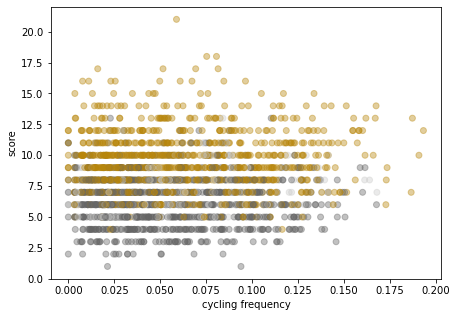

In [53]:
# Plot behavior frequency per game against scores and wins
from matplotlib.colors import LinearSegmentedColormap
cmap = LinearSegmentedColormap.from_list('', ['.4', '.8', 'darkgoldenrod'])

n_samples = 4501
behav_freq = np.sum(behavior, axis=3)[..., [0, 2], 0] / n_samples
fig, ax = plt.subplots(figsize=(7, 5))
ax.scatter(behav_freq.ravel(), scores.ravel(), c=wins_draw.ravel(), alpha=.4, cmap=cmap)
ax.set(ylabel='score', xlabel=f'{behavior_name} frequency');

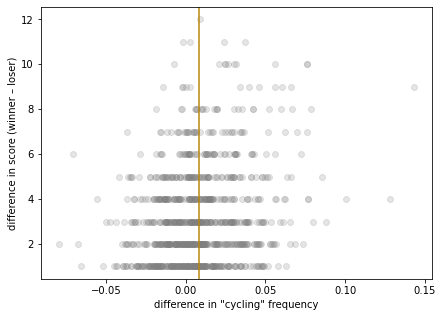

In [54]:
# Plot game-by-game difference in score against difference in behavior frequency
score_diff = scores[..., 0].ravel() - scores[..., 1].ravel()
score_sign = np.sign(score_diff)

non_ties = np.where(score_sign != 0)[0]

behav_diff = behav_freq[..., 0].ravel() - behav_freq[..., 1].ravel()
behav_win = behav_diff * score_sign

fig, ax = plt.subplots(figsize=(7, 5))
ax.scatter(behav_win[non_ties], np.abs(score_diff)[non_ties], c='.5', alpha=.2)
ax.set(xlabel=f'difference in "{behavior_name}" frequency',
       ylabel=f'difference in score (winner – loser)')
ax.axvline(np.mean(behav_win[non_ties]), c='darkgoldenrod');

In [55]:
# Print out some basic statistics
from scipy.stats import pearsonr, ttest_1samp

score_r, score_p = pearsonr(scores.ravel(), behav_freq.ravel())
print(f'correlation between score and behavior frequency: r = {score_r:.3f} (p = {score_p:.3f})')

win_t, win_p = ttest_1samp(behav_win[non_ties], popmean=0)
print(f'difference in behavior frequency for wins – losses: t = {win_t:.3f} (p = {win_p:.3f})')

correlation between score and behavior frequency: r = 0.085 (p = 0.000)
difference in behavior frequency for wins – losses: t = 9.657 (p = 0.000)


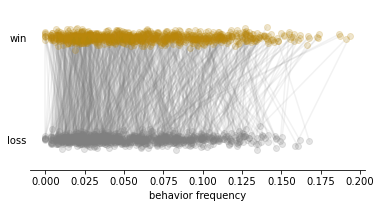

In [56]:
# Plot game-by-game behavior frequency for wins and losses
n_maps, n_repeats = 32, 32

freq_win, freq_loss = [], []
for map_id in np.arange(n_maps):
    for repeat_id in np.arange(n_repeats):
        if np.array_equal(wins_draw[map_id, repeat_id], [1, -1]):
            freq_win.append(behav_freq[map_id, repeat_id][0])
            freq_loss.append(behav_freq[map_id, repeat_id][1])
        elif np.array_equal(wins_draw[map_id, repeat_id], [-1, 1]):
            freq_win.append(behav_freq[map_id, repeat_id][1])
            freq_loss.append(behav_freq[map_id, repeat_id][0])

win_jitter = 1 + np.random.randn(len(freq_win)) / 30
loss_jitter = 0 + np.random.randn(len(freq_loss)) / 30

fig, ax = plt.subplots(figsize=(6, 3))
for i in np.arange(len(freq_win)):
    plt.plot([freq_win[i], freq_loss[i]],
             [win_jitter[i], loss_jitter[i]],
              c='.5', alpha=.1, zorder=-1)
plt.scatter(freq_win, win_jitter, alpha=.2, c='darkgoldenrod')
plt.scatter(freq_loss, loss_jitter, alpha=.2, c='.5')
ax.set(yticks=[0, 1], yticklabels=['loss', 'win'], ylim=(-.3, 1.3),
       xlabel='behavior frequency')
ax.tick_params(axis='y', which=u'both',length=0)
sns.despine(left=True)

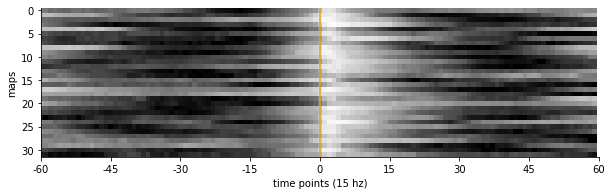

In [57]:
# Sum scoring epochs within maps across all repeats
pad = (60, 60)
score_epochs = []
for map_id in np.arange(n_maps):
    map_epochs = []
    for repeat_id in np.arange(n_repeats):
        map_epochs.extend(epoch_scores(wrap_f, behavior[map_id, repeat_id, [0, 2], :, 0],
                          pad=pad, map_id=map_id, repeat_id=repeat_id))
    score_epochs.append(np.sum(np.vstack(map_epochs), axis=0))

plot_epochs(np.vstack(score_epochs) / np.amax(np.vstack(score_epochs), axis=1)[:, np.newaxis],
            pad=pad, ylabel='maps')

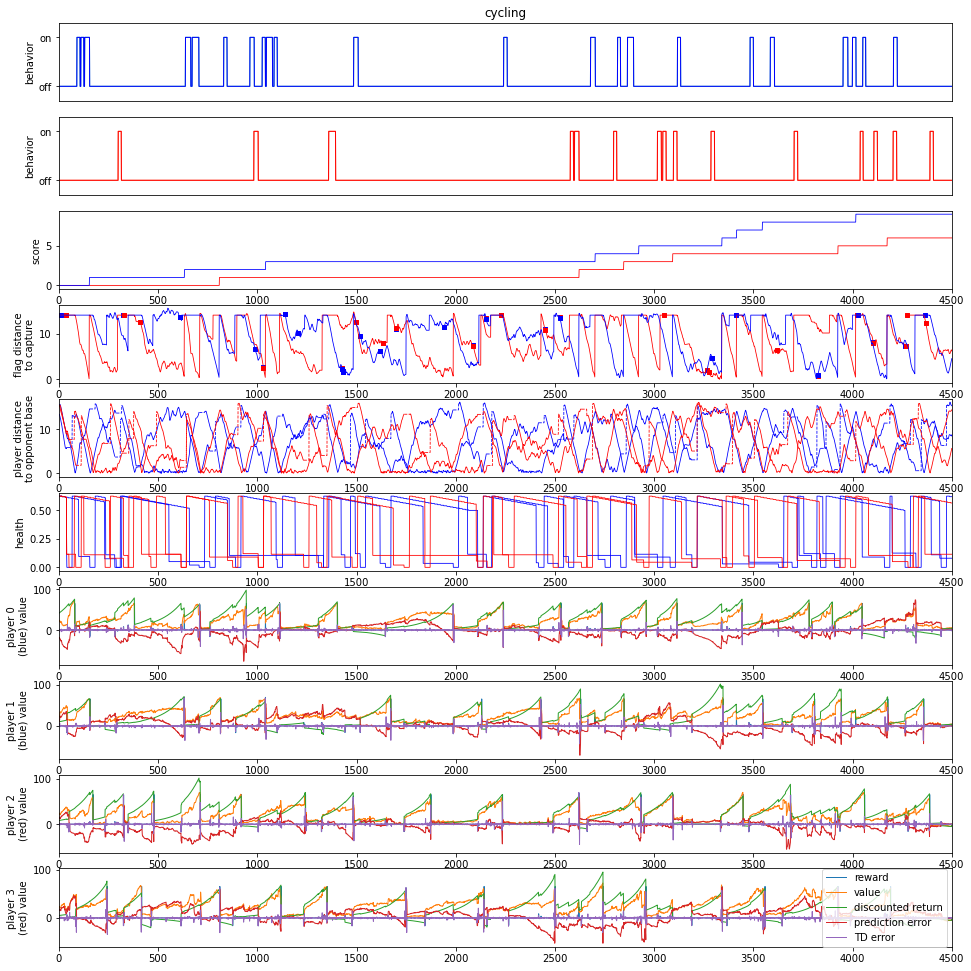

In [58]:
# Plot summary of behavior for one game
map_id, matchup_id, repeat_id = 0, 0, 0

behavior_game = behavior[map_id, repeat_id, ..., 0]

plot_behavior_summary(behavior_game, wrap_f, map_id=map_id,
                      matchup_id=matchup_id, repeat_id=repeat_id)

In [59]:
# Compute game-by-game difference in value when behavior is on/off
matchup_id = 0

on_value, off_value = [], []
diffs = []
for map_id in np.arange(n_maps):
    for repeat_id in np.arange(n_repeats):
        value = wrap_f['map/matchup/repeat/player/time/value'][
            map_id, matchup_id, repeat_id]
        on_mean = np.mean(value[behavior[map_id, repeat_id]])
        off_mean = np.mean(value[~behavior[map_id, repeat_id]])
        on_value.append(on_mean)
        off_value.append(off_mean)
        diff = (np.mean(value[behavior[map_id, repeat_id]]) - 
                np.mean(value[~behavior[map_id, repeat_id]]))
        diffs.append(diff)

# Compute player-by-player correlation between behavior and value
matchup_id = 0

value_r, value_p = (np.zeros((n_maps, n_repeats, 4)),
                    np.zeros((n_maps, n_repeats, 4)))
for map_id in np.arange(n_maps):
    for repeat_id in np.arange(n_repeats):
        for player_id in np.arange(4):
            value = wrap_f['map/matchup/repeat/player/time/value'][
                map_id, matchup_id, repeat_id, player_id]
            player_beh = behavior[map_id, repeat_id, player_id]
            r, p = pearsonr(value[:, 0], player_beh[:, 0])
            value_r[map_id, repeat_id, player_id] = r
            value_p[map_id, repeat_id, player_id] = p

corr_t, corr_p = ttest_1samp(np.nan_to_num(value_r.ravel()), popmean=0)
print(f'correlation between behavior indicator and value: {np.nanmean(value_r):.3f} '
      f'(t = {corr_t:.3f}, p = {corr_p:.3f})')

# Print out some basic statistics
value_t, value_p = ttest_1samp(np.nan_to_num(diffs), popmean=0)
print(f'difference in value for behavior on – off: t = {value_t:.3f} (p = {value_p:.3f})')

/jukebox/hasson/snastase/miniconda3/envs/ctf/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/jukebox/hasson/snastase/miniconda3/envs/ctf/lib/python3.7/site-packages/numpy/core/_methods.py:168: RuntimeWarning: invalid value encountered in true_divide
  ret = arr.dtype.type(ret / rcount)
/jukebox/hasson/snastase/miniconda3/envs/ctf/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


correlation between behavior indicator and value: -0.015 (t = -13.571, p = 0.000)
difference in value for behavior on – off: t = -12.182 (p = 0.000)


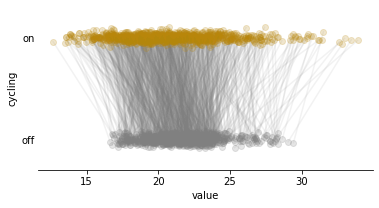

In [60]:
# Plot game-by-game difference in value for behavior on/off
on_jitter = 1 + np.random.randn(len(on_value)) / 30
off_jitter = 0 + np.random.randn(len(off_value)) / 30

fig, ax = plt.subplots(figsize=(6, 3))
for i in np.arange(len(on_value)):
    plt.plot([on_value[i], off_value[i]],
             [on_jitter[i], off_jitter[i]],
              c='.5', alpha=.1, zorder=-1)
plt.scatter(on_value, on_jitter, c='darkgoldenrod', alpha=.2)
plt.scatter(off_value, off_jitter, c='.5', alpha=.2)
ax.set(yticks=[0, 1], yticklabels=['off', 'on'], ylim=(-.3, 1.3),
       xlabel='value', ylabel=f'{behavior_name}')
ax.tick_params(axis='y', which=u'both',length=0)
sns.despine(left=True)